In [2]:
import sys

from quant_drl.environment.portfolio_environment import PortfolioEnvironment
from quant_drl.data.stock_data import StockData
from quant_drl.tester import Tester

from quant_drl.configurations import get_companies, get_complete_configuration


2025-04-16 12:34:08.911010: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-04-16 12:34:09.008434: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1744799649.054634    4599 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1744799649.070209    4599 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1744799649.146766    4599 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking 

In [3]:
import numpy as np
from datetime import datetime

In [28]:
n_companies = 10
configuation = get_complete_configuration(len_portfolio=n_companies)
tester = Tester(configuation)
base_path = "../models/DDPG/NoFeature/"
name = (
    "DDPG_reward_log_reward_normalize_standard_ncompanies_18_20250416-093443_lr_0.0001"
)
steps = 100000
tester.load_model(
    base_path,
    name,
    is_full_path=False,
    steps=steps,
    num_assets=n_companies,
    num_lstm_layers=4,
)

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********

Using cuda device


RuntimeError: Error(s) in loading state_dict for MultiInputPolicy:
	size mismatch for actor.mu.0.weight: copying a param with shape torch.Size([400, 9918]) from checkpoint, the shape in current model is torch.Size([400, 5510]).
	size mismatch for actor.mu.4.weight: copying a param with shape torch.Size([19, 300]) from checkpoint, the shape in current model is torch.Size([11, 300]).
	size mismatch for actor.mu.4.bias: copying a param with shape torch.Size([19]) from checkpoint, the shape in current model is torch.Size([11]).
	size mismatch for actor_target.mu.0.weight: copying a param with shape torch.Size([400, 9918]) from checkpoint, the shape in current model is torch.Size([400, 5510]).
	size mismatch for actor_target.mu.4.weight: copying a param with shape torch.Size([19, 300]) from checkpoint, the shape in current model is torch.Size([11, 300]).
	size mismatch for actor_target.mu.4.bias: copying a param with shape torch.Size([19]) from checkpoint, the shape in current model is torch.Size([11]).
	size mismatch for critic.qf0.0.weight: copying a param with shape torch.Size([400, 9937]) from checkpoint, the shape in current model is torch.Size([400, 5521]).
	size mismatch for critic_target.qf0.0.weight: copying a param with shape torch.Size([400, 9937]) from checkpoint, the shape in current model is torch.Size([400, 5521]).

In [26]:
print(tester.model.policy)

MultiInputPolicy(
  (actor): Actor(
    (features_extractor): CustomLSTMFeatureExtractor(
      (lstm): LSTM(110, 10, num_layers=4, batch_first=True, dropout=0.2)
      (fc_weight): Linear(in_features=10, out_features=10, bias=True)
      (conv1d_common): Conv1d(33, 32, kernel_size=(1,), stride=(1,))
      (bn_common): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (mu): Sequential(
      (0): Linear(in_features=320, out_features=400, bias=True)
      (1): ReLU()
      (2): Linear(in_features=400, out_features=300, bias=True)
      (3): ReLU()
      (4): Linear(in_features=300, out_features=11, bias=True)
      (5): Tanh()
    )
  )
  (actor_target): Actor(
    (features_extractor): CustomLSTMFeatureExtractor(
      (lstm): LSTM(110, 10, num_layers=4, batch_first=True, dropout=0.2)
      (fc_weight): Linear(in_features=10, out_features=10, bias=True)
      (conv1d_common): Conv1d(33, 32, kernel_size=(1,), stride=(1,))
      (bn_common): BatchN

In [29]:
total_params = sum(
    p.numel() for p in tester.model.policy.parameters() if p.requires_grad
)
print(f"Total de parámetros entrenables del modelo: {total_params}")

Total de parámetros entrenables del modelo: 9314824


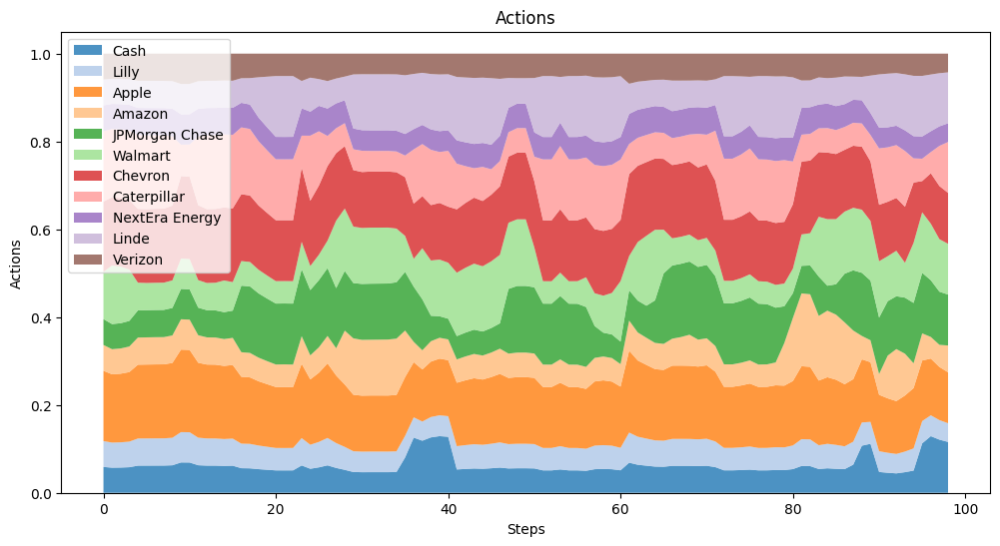

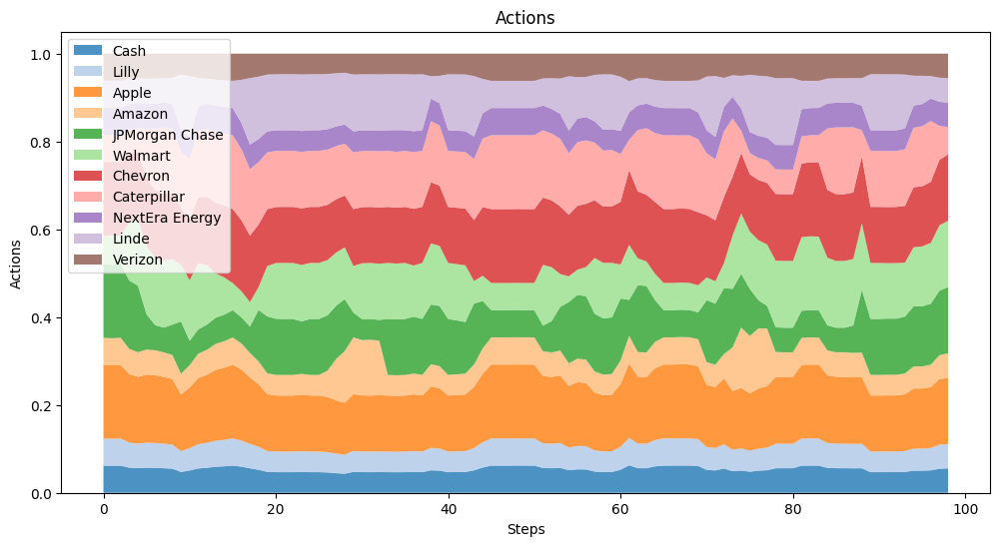

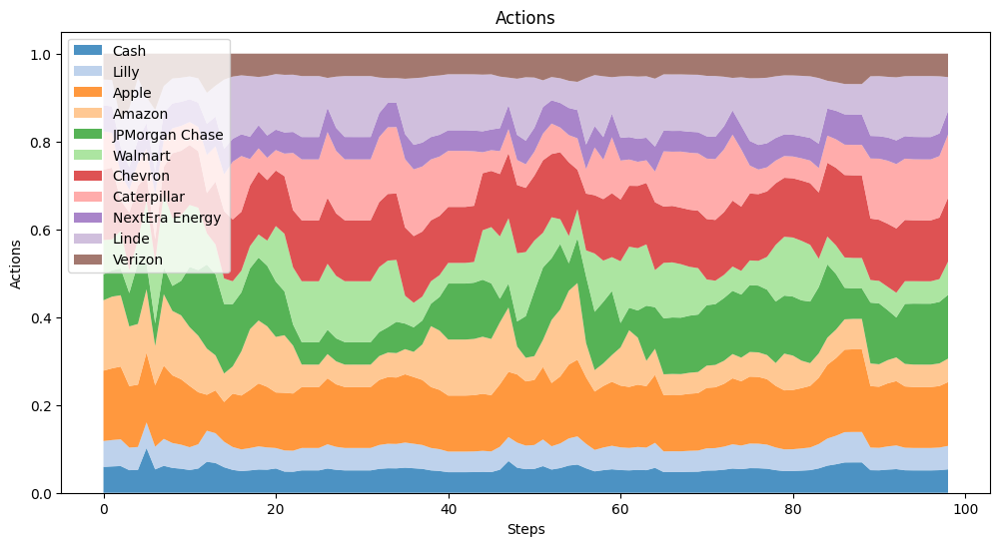

{'final_rewards': [0.12958729834281257,
  0.07966825776384212,
  0.09245494149217848],
 'final_pvs': [np.float64(11383.573563204649),
  np.float64(10829.266826095567),
  np.float64(10968.626286688994)],
 'final_drawdowns': [np.float64(0.04865676149723578),
  np.float64(0.030086621274182015),
  np.float64(0.06471926063723138)],
 'mean_rewards': [0.0013089626095233594,
  0.0008047298764024456,
  0.0009338882979007927],
 'mean_sharpes': [0.13110350675769178,
  0.08505575507596716,
  0.30215737077662036],
 'mean_pvs': [10635.851110964313, 10391.522828354182, 10671.101528548465],
 'std_rewards': [0.006986312750620685,
  0.007317198177018135,
  0.006285175240879099],
 'std_sharpes': [0.10176641217581689,
  0.07070456739622909,
  0.28668151497725286],
 'std_pvs': [467.8833981821958, 252.01576533817143, 258.3663061595473],
 'all_rewards': [[-0.008772698231041431,
   -0.007339319214224815,
   0.0001995147467823699,
   -0.00302336597815156,
   0.007451948244124651,
   0.01311845425516367,
   -0.

In [22]:
tester.evaluate(env="eval", num_episodes=3, show_results=True)

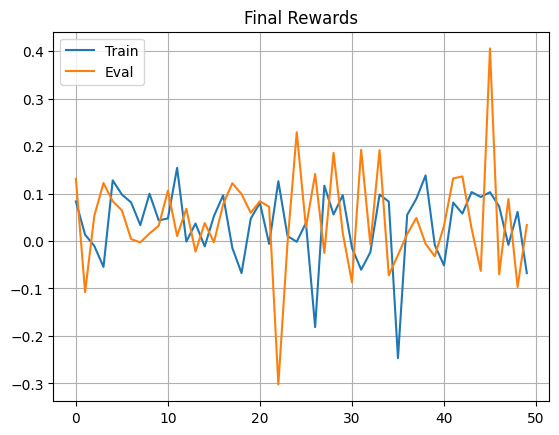

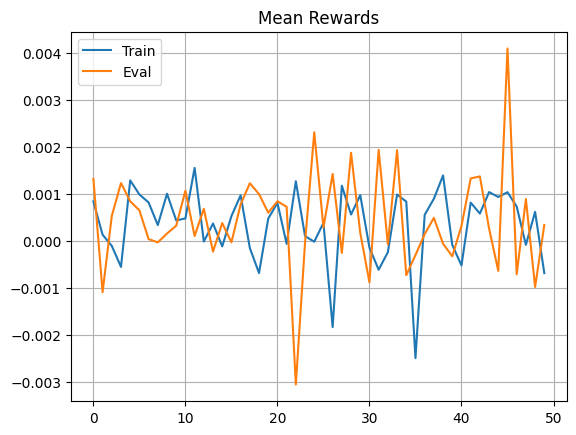

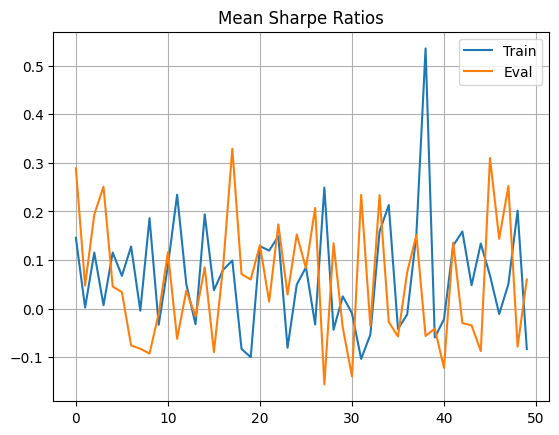

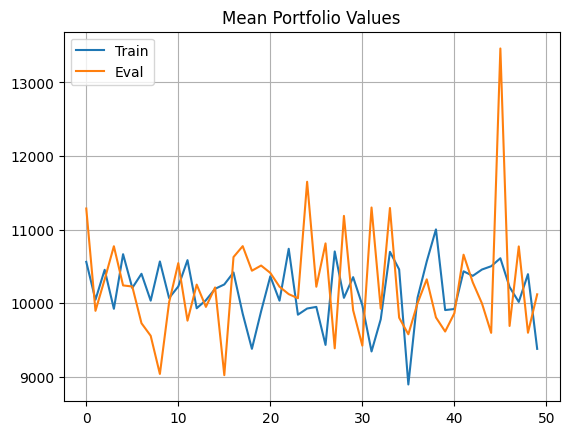

({'final_rewards': [0.08330689349622844,
   0.013243001412774902,
   -0.010369648329287884,
   -0.0546111738512991,
   0.1276895441696979,
   0.09784122997371014,
   0.0811726460524369,
   0.03349574588355608,
   0.09951585158341913,
   0.04334075224824119,
   0.04756274291139562,
   0.15391919227840845,
   -0.0011722465860657394,
   0.03686543881485704,
   -0.01144423113873927,
   0.0523653212148929,
   0.09621510627766838,
   -0.014657289219030645,
   -0.06761304062092677,
   0.047097957525693346,
   0.0802773309769691,
   -0.006176241899083834,
   0.12586790247587487,
   0.010293433355400339,
   -0.0015445390599779785,
   0.03810649263323285,
   -0.18134746150462888,
   0.1163736213275115,
   0.055811448582971934,
   0.09655646339524537,
   -0.014342357026180252,
   -0.060517623503983486,
   -0.023628812938113697,
   0.09781064779963344,
   0.08289300323849602,
   -0.2467237500623014,
   0.05500003534689313,
   0.0889634311752161,
   0.13808735458587762,
   -0.008494768029777333,
  

In [15]:
tester.compare_train_eval(num_episodes=50, show_results=True)